In [1]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import NaiveDE
from sklearn.preprocessing import scale
from sklearn.mixture import BayesianGaussianMixture
import seaborn as sns
import umap
from tqdm import tqdm
import networkx as nx
from scipy.cluster.hierarchy import dendrogram, to_tree
from matplotlib.colors import to_rgb
import warnings
warnings.filterwarnings('ignore')

path = '../../data/graph_iss_data/graph-iss/'
figure_path = '../../thesis/figures/'

#### Number of common genes in the two gene panels

In [2]:
tagList_df1 = pd.read_csv(path + "data/tagList_84-gene.csv", sep = ",", usecols = [0,1], header = None, names = ["Seq","Gene"])
tagList_df2 = pd.read_csv(path + "data/taglist1441_1442.csv", sep = ",", usecols = [0,1], header = None, names = ["Seq","Gene"])
common_genes = tagList_df1.Gene.unique()[np.isin(tagList_df1.Gene.unique(),tagList_df2.Gene.unique())]
common_genes.shape

(82,)

# Load data and quality filtering

In [3]:
def T_quality(x):
    return np.clip(1-np.log(1+x)/3.9,0,1)


Q_th = 2
min_count = 500
barcodes_df = []

datasets = ['170315_161220_4_1','161230_161220_3_1','1442_hippo','1442_OB']
taglists = ['tagList_99-gene.csv', 'tagList_84-gene.csv','taglist1441_1442.csv','taglist1441_1442.csv']
for s, sample in tqdm(enumerate(datasets)):
    tagList_df = pd.read_csv(path + "data/"+taglists[s], sep = ",", usecols = [0,1], header = None, names = ["Seq","Gene"])
    df = pd.read_csv(path + "data/results/"+sample+"/barcodes.csv", sep = ",")
    df.seq_quality_min=df.seq_quality_min*df.max_dist.apply(T_quality)
    # Add gene names to dataframe
    d = pd.Series(tagList_df.Gene.values,index=tagList_df.Seq).to_dict()
    df["Gene"] = df['letters'].map(d)
    # Downsample barcode coordinate space by factor 8 for easier visualization
    df["global_X_pos"]=df.global_X_pos/8
    df["global_Y_pos"]=df.global_Y_pos/8
    # Remove reads not in the codebook
    df = df.dropna()
    print(sample, df.shape[0], df.Gene.unique().shape[0])
    # Filter reads by quality
    df = df[df.seq_quality_min>Q_th]
    # Filter reads by min count per gene
    df["count"] = 0
    for i,row in tagList_df.iterrows():
        df.loc[df["Gene"] == tagList_df.Gene[i],["count"]] = len(df[df["Gene"] == tagList_df.Gene[i]])
    df = df[df["count"]>min_count]
    # Leave only genes presents in all panels
    df = df[df.Gene.isin(common_genes)]
    df.reset_index(drop=True, inplace=True)
    
    barcodes_df.append(df)

0it [00:00, ?it/s]

170315_161220_4_1 1955408 97


1it [02:22, 142.61s/it]

161230_161220_3_1 1202760 82


2it [03:55, 127.70s/it]

1442_hippo 1011961 97


3it [05:12, 112.48s/it]

1442_OB 174938 97


4it [05:26, 82.95s/it] 


## Generate expression tables
Generate gene expression table dividing the sample in overlapping patches. The gene expression of each overlapping patch is an entry row int the expression table. Using overlapping patches help to smooth the gene expression between neighbooring patches and consequently to reduce noise.

In [ ]:
# Import and downsample by factor 8 image shape
img_shape = np.round(np.array([[22508, 33566],[22563, 31782],[22635, 29861],[13260, 15052]])/8).astype(np.uint)

# Create gene expression table
expression_df = []
sample_df = []
for s_idx, df in enumerate(barcodes_df):
    x_min = 0; x_max= img_shape[s_idx,1];
    y_min = 0; y_max= img_shape[s_idx,0];
    batch_size_px=16
    overlap = 16

    express_table = pd.DataFrame(data={}, columns=df.Gene.unique(), index=list((str(x)+"x"+str(y)) for x in range(x_min,x_max,batch_size_px) for y in range(y_min,y_max,batch_size_px))) 
    for i in tqdm(range(x_min,x_max,batch_size_px)):
        for j in range(y_min,y_max,batch_size_px):
            batch_df=df[(df.global_X_pos>=i-(batch_size_px/2)-overlap) & (df.global_X_pos<i+(batch_size_px/2)+overlap) & (df.global_Y_pos>=j-(batch_size_px/2)-overlap) & (df.global_Y_pos<j+(batch_size_px/2)+overlap)]
            if len(batch_df):
                batch_counts = batch_df['Gene'].value_counts()
                express_table.loc[str(i)+'x'+str(j),batch_counts.index]=batch_counts
                
    express_table = express_table.fillna(0)

    # Create sample_info
    sample_info = pd.DataFrame(data={'x':list(x for x in range(x_min,x_max,batch_size_px) for y in range(y_min,y_max,batch_size_px)), 'y':list(y for x in range(x_min,x_max,batch_size_px) for y in range(y_min,y_max,batch_size_px))}, index=list((str(x)+"x"+str(y)) for x in range(x_min,x_max,batch_size_px) for y in range(y_min,y_max,batch_size_px)))
    sample_info['total_counts'] = express_table.sum(axis=1)
    # Dropping empty batches
    express_table = express_table[sample_info.total_counts>10]
    sample_info = sample_info[sample_info.total_counts>10]
    
    expression_df.append(express_table)
    sample_df.append(sample_info)



In [ ]:
# save dataframes
for i,dataset in enumerate(datasets):
    expression_df[i].to_pickle(path + 'data/results/'+dataset+'/express_table.hdf5')
    sample_df[i].to_pickle(path + 'data/results/'+dataset+'/sample_info.hdf5')

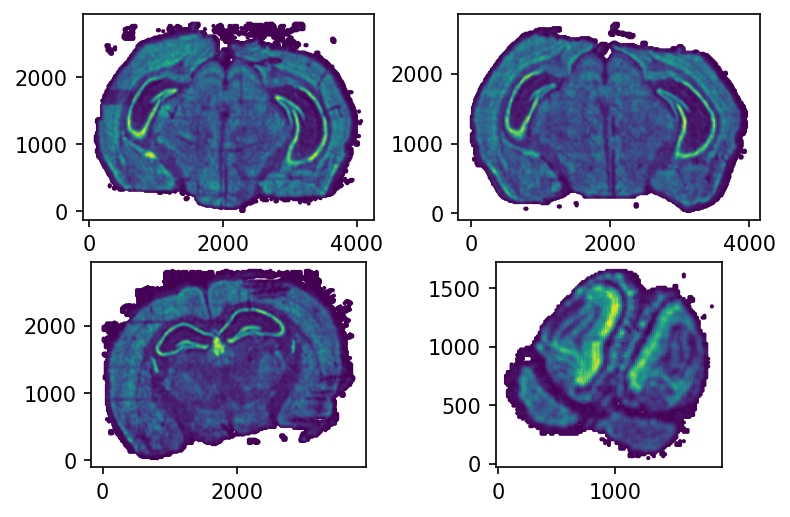

In [4]:
# load dataframes
img_shape = np.round(np.array([[22508, 33566],[22563, 31782],[22635, 29861],[13260, 15052]])/8).astype(np.uint)
expression_df = []
sample_df = []
for i,dataset in enumerate(datasets):
    plt.rcParams["figure.dpi"] = 150
    plt.subplot(2,2,i+1)    
    
    x_min = 0; x_max= img_shape[i,1];
    y_min = 0; y_max= img_shape[i,0];
    batch_size_px=16
    overlap = 16
    express_table = pd.read_pickle(path + 'data/results/'+dataset+'/express_table.hdf5')
    # Create sample_info 6
    sample_info = pd.DataFrame(data={'x':list(x for x in range(x_min,x_max,batch_size_px) for y in range(y_min,y_max,batch_size_px)), 'y':list(y for x in range(x_min,x_max,batch_size_px) for y in range(y_min,y_max,batch_size_px))}, index=list((str(x)+"x"+str(y)) for x in range(x_min,x_max,batch_size_px) for y in range(y_min,y_max,batch_size_px)))
    sample_info['total_counts'] = express_table.sum(axis=1)
    # Dropping empty batches
    express_table = express_table[sample_info.total_counts>10]
    sample_info = sample_info[sample_info.total_counts>10]
    
    expression_df.append(express_table)
    expression_df[i] = expression_df[i].rename(('{}_'+str(i)).format)

    sample_df.append(sample_info)
    sample_df[i] = sample_df[i].rename(('{}_'+str(i)).format)
    sample_df[i]['s'] = i
    plt.scatter(sample_df[i]['x'], sample_df[i]['y'], c=sample_df[i]['total_counts'],s=1);
    plt.axis('scaled');

## Normalize Gene Expression Tables

In [5]:
expression_df=pd.concat(expression_df,sort=True)
expression_df=expression_df.fillna(0)
sample_df=pd.concat(sample_df,sort=True)
                    
# Linear regression to account for library size and sequencing depth bias of each patch of gene expression
norm_expr_list = []
resid_expr_list = []
for s, dataset in enumerate(datasets):
    norm_expr_list.append(NaiveDE.stabilize(expression_df[sample_df.s==s].T).T)
    resid_expr_list.append(NaiveDE.regress_out(sample_df[sample_df.s==s], norm_expr_list[s][sample_df.s==s].T, 'np.log(total_counts)').T)

norm_expr = pd.concat(norm_expr_list)
resid_expr = pd.concat(resid_expr_list)
idx = resid_expr.var().sort_values(ascending=False).index

#### Total expressed genes in the four sections

In [6]:
idx.shape[0]

78

#### Number of expressed genes in each dataset

In [7]:
for s, dataset in enumerate(datasets):
    print(dataset, barcodes_df[s].Gene.unique().shape[0])

170315_161220_4_1 75
161230_161220_3_1 76
1442_hippo 73
1442_OB 45


#### Number of commonly expressed genes

In [8]:
np.intersect1d(np.intersect1d(np.intersect1d(barcodes_df[0].Gene.unique(),barcodes_df[1].Gene.unique()), barcodes_df[2].Gene.unique()), barcodes_df[3].Gene.unique()).shape[0]

45

## Gene Expression Continuum
Visualize gene expression variantion on sample. Normalized gene expression tables are projected in 3D dimensional embedding and and each entry of the expression table is color coded according to its location 3d space of the embedding. Consequently patches that have similar gene expression signature they will have similar colors.

In [9]:
reducer = umap.UMAP(
        n_neighbors=100,
        min_dist=0.5,
        n_components=3,
        metric='correlation',
        random_state=42,
        init='spectral')

scaled_expr = np.vstack((scale(resid_expr.loc[sample_df.s==0,idx], 1),scale(resid_expr.loc[sample_df.s==1,idx], 1),scale(resid_expr.loc[sample_df.s==2,idx], 1),scale(resid_expr.loc[sample_df.s==3,idx], 1)))
Y_umap = reducer.fit_transform(scaled_expr)
Y_umap -= np.min(Y_umap, axis=0)
Y_umap /= np.max(Y_umap, axis=0)

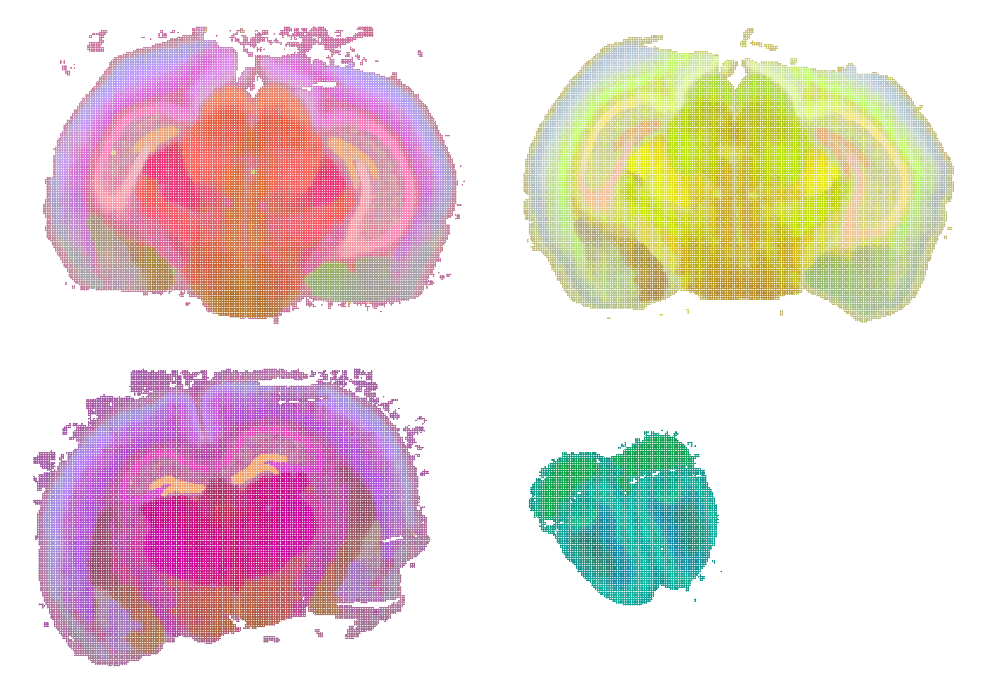

In [12]:
fig=plt.figure(figsize=(10,7),dpi=500)

ax1 = fig.add_subplot(2,2,1, facecolor='white', frameon = False)
# plt.subplot(2,2,1)
plt.scatter(sample_df.loc[sample_df.s==0,:].x, sample_df.loc[sample_df.s==0,:].y, c=Y_umap[sample_df.s==0,:], s=1, linewidths=0, rasterized=True);
plt.xticks([])
plt.yticks([]);
plt.axis('scaled');


ax = fig.add_subplot(2,2,2, facecolor='white', frameon =False, sharex=ax1)
# plt.subplot(2,2,2)
plt.scatter(sample_df.loc[sample_df.s==1,:].x, sample_df.loc[sample_df.s==1,:].y, c=Y_umap[sample_df.s==1,:], s=1, linewidths=0, rasterized=True);
plt.xticks([])
plt.yticks([]);
plt.axis('scaled');

ax = fig.add_subplot(2,2,3, facecolor='white', frameon =False, sharex=ax1)
# plt.subplot(2,2,3)
plt.scatter(sample_df.loc[sample_df.s==2,:].x, sample_df.loc[sample_df.s==2,:].y, c=Y_umap[sample_df.s==2,:], s=1, linewidths=0, rasterized=True);
plt.xticks([])
plt.yticks([]);
plt.axis('scaled');

ax = fig.add_subplot(2,2,4, facecolor='white', frameon =False, sharex=ax1)
# plt.subplot(2,2,4)
plt.scatter(sample_df.loc[sample_df.s==3,:].x, -sample_df.loc[sample_df.s==3,:].y, c=Y_umap[sample_df.s==3,:], s=1, linewidths=0, rasterized=True);
plt.xticks([])
plt.yticks([]);
plt.axis('scaled');

plt.subplots_adjust(hspace=0.05, wspace=0.02)

fig.savefig(figure_path + 'continuum-full-gene-panel.svg', dpi=600)

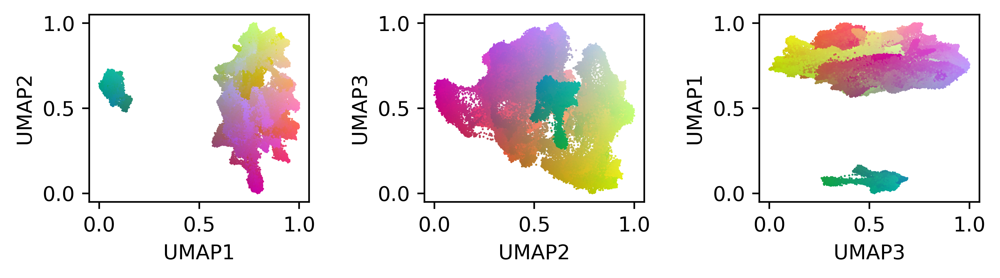

In [22]:
fig=plt.figure(figsize=(7,2),dpi=500)
cycled = [0,1,2,0]
for i in range(3):
    plt.subplot(1,3,i+1)
    plt.scatter(Y_umap[:,cycled[i]], Y_umap[:,cycled[i+1]], c=Y_umap, s=1, linewidths=0)
    plt.xlabel("UMAP"+str(cycled[i]+1))
    plt.ylabel("UMAP"+str(cycled[i+1]+1))
plt.tight_layout()       
fig.savefig(figure_path + 'continuum-full-gene-panel_b.png')

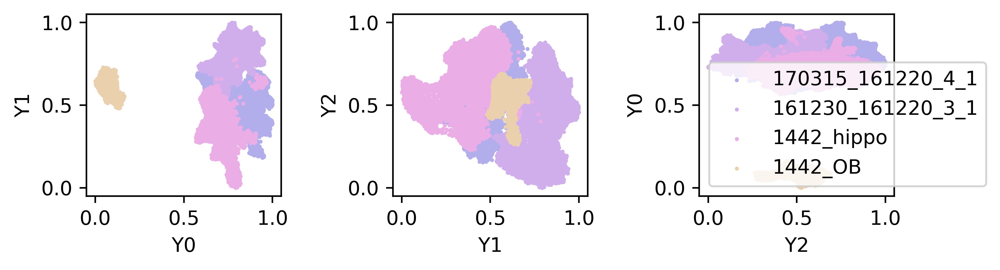

In [23]:
colors=["#B2ADEB", "#D0ADEB", "#EBADE6", "#EBD0AD"]

fig=plt.figure(figsize=(7,2),dpi=500)
cycled = [0,1,2,0]
for i in range(3):
    plt.subplot(1,3,i+1)
    plt.scatter(Y_umap[sample_df.s==0,cycled[i]], Y_umap[sample_df.s==0,cycled[i+1]],s=1, c=colors[0], label=datasets[0])
    plt.scatter(Y_umap[sample_df.s==1,cycled[i]], Y_umap[sample_df.s==1,cycled[i+1]],s=1, c=colors[1], label=datasets[1])
    plt.scatter(Y_umap[sample_df.s==2,cycled[i]], Y_umap[sample_df.s==2,cycled[i+1]],s=1, c=colors[2], label=datasets[2])
    plt.scatter(Y_umap[sample_df.s==3,cycled[i]], Y_umap[sample_df.s==3,cycled[i+1]],s=1, c=colors[3], label=datasets[3])
    plt.xlabel("Y"+str(cycled[i]))
    plt.ylabel("Y"+str(cycled[i+1]))
plt.legend(fontsize=10)
plt.tight_layout()

## Gene Expression Clusters
Dimensionality reduction and clustering is applied to each normalized gene expression table, subdividing each brain section in 30 regions.

In [9]:
# UMAP projection
reducer = umap.UMAP(
        n_neighbors=100,
        min_dist=0.25,
        n_components=50,
        metric='correlation',
        random_state=42,
        init='spectral'
    )

scaled_expr = np.vstack((scale(resid_expr.loc[sample_df.s==0,idx], 1),scale(resid_expr.loc[sample_df.s==1,idx], 1),scale(resid_expr.loc[sample_df.s==2,idx], 1),scale(resid_expr.loc[sample_df.s==3,idx], 1)))
Y_umap = reducer.fit_transform(scaled_expr)
Y=Y_umap

In [10]:
# Leiden clustering
import scanpy as sc

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()

for i,df in enumerate(datasets):
    adata = sc.AnnData(X=Y[sample_df.s==i,:])
    sc.pp.neighbors(adata, n_neighbors=100)
    # Run Leiden clustering algorithm
    sc.tl.leiden(adata, resolution=0.8, random_state = 42)
    phi_hat = adata.obs['leiden'].values.astype(int)
    
    sample_df.loc[sample_df.s==i,'U1'] = Y[sample_df.s==i, 0]
    sample_df.loc[sample_df.s==i,'U2'] = Y[sample_df.s==i, 1]
    sample_df.loc[sample_df.s==i,'cluster'] = phi_hat    

scanpy==1.5.1 anndata==0.7.3 umap==0.3.10 numpy==1.18.1 scipy==1.4.1 pandas==1.0.1 scikit-learn==0.21.3 statsmodels==0.11.1 python-igraph==0.8.2 leidenalg==0.8.0
computing neighbors
    using data matrix X directly
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:29)
running Leiden clustering
    finished: found 32 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:35)
computing neighbors
    using data matrix X directly
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:28)
running Leiden clustering
    finished: found 32 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:37)
computing neighbors
    using data matrix X directly
    finished: added to `.uns['neighbors']`
    `.obsp['distan

In [11]:
cluster_id_dict = dict(zip(sample_df.loc[:,['s','cluster']].drop_duplicates().apply(tuple, axis=1).values, np.arange(sample_df.loc[:,['s','cluster']].drop_duplicates().values.shape[0])))

sample_df['cluster_id'] = sample_df.apply(lambda x: cluster_id_dict[(x['s'],x['cluster'])], axis=1)

In [12]:
# Save clusters
for i,df in enumerate(datasets):
    sample_df_tmp = sample_df.loc[sample_df.s==i].copy()
    sample_df_tmp.loc[:,['x','y']] = sample_df_tmp.loc[:,['x','y']]*8
    sample_df_tmp.to_csv('../data/results/'+df+'/clusters.csv', index=False)

In [13]:
# Clusters Gene Expression Table
cluster_df = []
for i,df in enumerate(datasets):
    clusters=[]
    for c in np.unique(sample_df.loc[sample_df.s==i,'cluster_id']):
        clusters.append(expression_df.loc[sample_df[(sample_df.s==i) & (sample_df.cluster_id==c)].index,:])

    cluster_exp_tab = np.zeros((len(np.unique(sample_df.loc[sample_df.s==i,'cluster_id'])),len(expression_df.columns.values)))

    for c, cluster in enumerate(np.unique(sample_df.loc[sample_df.s==i,'cluster_id'])):
        for g, gene in enumerate(expression_df.columns.values):
            # Normalizationtion by cluster area
            cluster_exp_tab[c,g] = clusters[c].loc[:,gene].sum()/len(clusters[c])

    # Normalize by gene (column)
    cluster_exp_tab=cluster_exp_tab/cluster_exp_tab.sum(axis=0)[None,:]
    
    cluster_df.append(pd.DataFrame(cluster_exp_tab,columns=expression_df.columns, index=np.unique(sample_df.loc[sample_df.s==i,'cluster_id']) ))

c=np.array(["#B2ADEB"]*len(cluster_df[0])).tolist() + np.array(["#D0ADEB"]*len(cluster_df[1])).tolist() + np.array(["#EBADE6"]*len(cluster_df[2])).tolist() + np.array(["#EBD0AD"]*len(cluster_df[3])).tolist()
cluster_exp_tab=pd.concat(cluster_df,sort=True)
cluster_exp_tab=cluster_exp_tab.fillna(0)

Clustering regions from the four sections are then combined together with hierarchical clustering based on the gene expression profile of each cluster regions

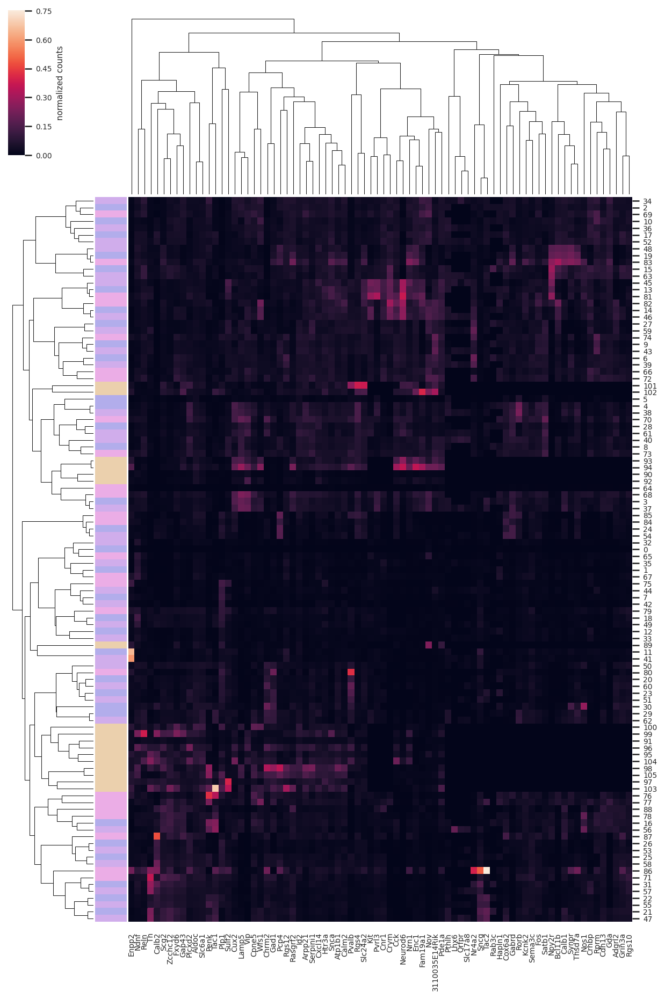

In [14]:
# Plot clustermap
sns.set(font_scale = 0.6)
g=sns.clustermap(cluster_exp_tab,xticklabels=True, yticklabels=True, metric='correlation',row_colors=c, figsize=(10,15),  cbar_kws={'label': 'normalized counts'})
g.savefig(figure_path + 'gene_expr_clustermap.pdf')

In [9]:
# Get linkage matrix
def inorder(tree,G):
    if tree:
        if tree.left:
            G.add_edge(tree.id, tree.left.id)
        if tree.right:
            G.add_edge(tree.id, tree.right.id)
        inorder(tree.left,G)
        inorder(tree.right,G)

def nodes_connected(u, v, G):
    return u in G.neighbors(v)

In [16]:
G= nx.DiGraph()

Z= g.dendrogram_row.linkage
T = to_tree( Z , rd=False )
inorder(T,G)

dend = dendrogram(Z,
           truncate_mode='lastp',  # show only the last p merged clusters
           p=20,  # show only the last p merged clusters
           no_plot=True
           )
leafs = [x for x in G.nodes() if G.out_degree(x)==0]
truncated_dend_leafs = dend["leaves"]
color_clusters = []
i=0
for n in truncated_dend_leafs:
    n_list =[]
    for l in leafs:
        if nx.has_path(G,n,l):
            n_list.append(l)
    color_clusters.append(n_list)
    i=i+1    

cluster_exp_tab_idx = cluster_exp_tab.index.tolist()

In [17]:
color_clusters

[[34, 2, 69, 10, 36, 17, 52],
 [48, 19, 83, 15, 63],
 [45, 13, 81, 82, 14, 46],
 [27, 59, 74, 9, 43, 6, 39, 66, 72],
 [101, 102],
 [5, 4, 38, 70, 28, 61, 40, 8, 73],
 [93, 94, 90, 92, 64, 68, 3, 37],
 [85, 84, 24, 54],
 [32, 0, 65, 35, 1, 67],
 [75, 44, 7, 42, 79, 18, 49, 12, 33],
 [89],
 [11, 41],
 [50, 80, 20, 60, 23, 51, 30, 29, 62],
 [100, 99, 91, 96, 95, 104],
 [98, 105],
 [97, 103],
 [76, 77],
 [88, 78, 16, 56],
 [87, 26, 53, 25, 58],
 [86, 71, 31, 57, 22, 55, 21, 47]]

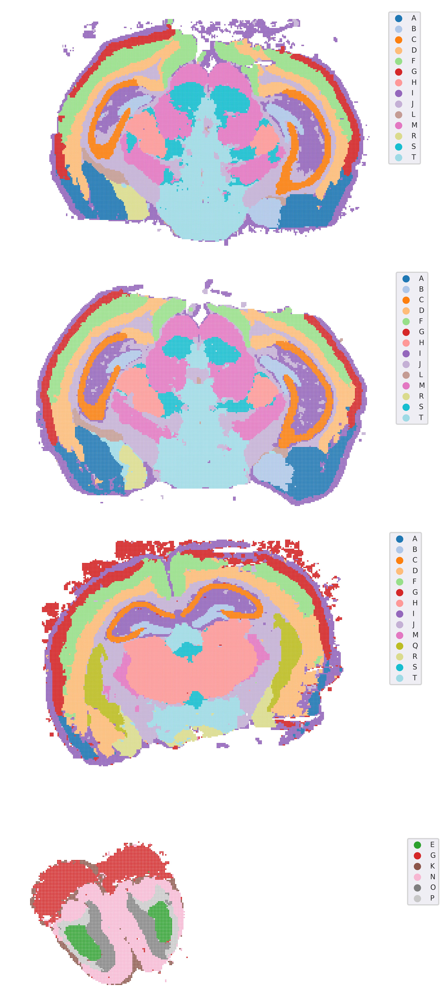

In [18]:
from cycler import cycler
import matplotlib as mpl
from matplotlib.colors import to_rgb
mpl.rcParams['axes.prop_cycle'] = cycler(color=["#1f77b4","#aec7e8","#ff7f0e","#ffbb78","#2ca02c","#98df8a","#d62728","#ff9896","#9467bd","#c5b0d5","#8c564b","#c49c94","#e377c2","#f7b6d2","#7f7f7f","#c7c7c7","#bcbd22","#dbdb8d","#17becf","#9edae5"])
c_list=["#1f77b4","#aec7e8","#ff7f0e","#ffbb78","#2ca02c","#98df8a","#d62728","#ff9896","#9467bd","#c5b0d5","#8c564b","#c49c94","#e377c2","#f7b6d2","#7f7f7f","#c7c7c7","#bcbd22","#dbdb8d","#17becf","#9edae5"]

fig=plt.figure(figsize=(6,16),dpi=500)


ax1 = fig.add_subplot(4,1,1, facecolor='white', frameon =False)
c_label = [chr(x) for x in range(65,91)]

i=0
for c in color_clusters:
    g = sample_df.loc[(sample_df.s==0) & (sample_df.cluster_id.isin(c)),:]
    if not g.empty:
        plt.scatter(g.x, g.y, label=c_label[i], c=np.array([np.array(to_rgb(c_list[i])),]*len(g.x)), s=1.5, linewidths=0, rasterized=True)
    i = i+1
    
plt.xticks([])
plt.yticks([]);
plt.axis('scaled');
ax1.spines['right'].set_color('black')
ax1.spines['left'].set_color('black')
ax1.spines['top'].set_color('black')
ax1.spines['bottom'].set_color('black')
plt.legend(bbox_to_anchor=(1, 1),loc=2, markerscale=5. ,prop={'size': 6})

ax = fig.add_subplot(4,1,2, facecolor='white', frameon =False, sharex=ax1)
i=0
for c in color_clusters:
    g = sample_df.loc[(sample_df.s==1) & (sample_df.cluster_id.isin(c)),:]
    if not g.empty:
        plt.scatter(g.x, g.y, label=c_label[i], c=np.array([np.array(to_rgb(c_list[i])),]*len(g.x)), s=1.5, linewidths=0, rasterized=True)
    i = i+1
    
plt.xticks([])
plt.yticks([]);
plt.axis('scaled');
ax.spines['right'].set_color('black')
ax.spines['left'].set_color('black')
ax.spines['top'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.legend(bbox_to_anchor=(1, 1),loc=2, markerscale=5. ,prop={'size': 6})

ax = fig.add_subplot(4,1,3, facecolor='white', frameon =False, sharex=ax1)
i=0
for c in color_clusters:
    g = sample_df.loc[(sample_df.s==2) & (sample_df.cluster_id.isin(c)),:]
    if not g.empty:
        plt.scatter(g.x, g.y, label=c_label[i], c=np.array([np.array(to_rgb(c_list[i])),]*len(g.x)), s=1.5, linewidths=0, rasterized=True)
    i = i+1
    
plt.xticks([])
plt.yticks([]);
plt.axis('scaled');
ax.spines['right'].set_color('black')
ax.spines['left'].set_color('black')
ax.spines['top'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.legend(bbox_to_anchor=(1, 1),loc=2, markerscale=5. ,prop={'size': 6})

ax = fig.add_subplot(4,1,4, facecolor='white', frameon =False, sharex=ax1)
i=0
for c in color_clusters:
    g = sample_df.loc[(sample_df.s==3) & (sample_df.cluster_id.isin(c)),:]
    if not g.empty:
        plt.scatter(g.x, -g.y, label=c_label[i], c=np.array([np.array(to_rgb(c_list[i])),]*len(g.x)), s=1.5, linewidths=0, rasterized=True)
    i = i+1
    
plt.xticks([])
plt.yticks([]);
plt.axis('scaled');
ax.spines['right'].set_color('black')
ax.spines['left'].set_color('black')
ax.spines['top'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.legend(bbox_to_anchor=(1, 1),loc=2, markerscale=5. ,prop={'size': 6})

plt.subplots_adjust(hspace=0.05, wspace=0.02)

fig.savefig(figure_path + 'clusters-full-gene-panel.svg', dpi=600)

In [20]:
# Save sample_df dataframe
for i,c in enumerate(color_clusters):
    sample_df.loc[sample_df.cluster_id.isin(c),'top_cluster'] = i
    sample_df.to_csv('../data/results/sample_info.csv')

Plot subclusters of 20 top cluster regions

In [21]:
c1 = cluster_df[0]; s1 = sample_df[sample_df.s==0]
c2 = cluster_df[1]; s2 = sample_df[sample_df.s==1]
c3 = cluster_df[2]; s3 = sample_df[sample_df.s==2]
c4 = cluster_df[3]; s4 = sample_df[sample_df.s==3]
# Find sub-clusters
color_clusters = []
for n in truncated_dend_leafs:
    leafs = [x for x in G.nodes() if G.out_degree(x)==0 and nx.has_path(G,n,x)]
    succ = list(G.successors(n))
    color_subclusters = []
    for s in succ:
#         if not s in leafs:# cluster composed by multiple sub-clusters
        color_subclusters.append([x for x in G.nodes() if G.out_degree(x)==0 and nx.has_path(G,s,x)])
    color_clusters.append(color_subclusters)

In [22]:
color_clusters

[[[34, 2, 69], [10, 36, 17, 52]],
 [[48, 19, 83], [15, 63]],
 [[45, 13, 81], [82, 14, 46]],
 [[27, 59], [74, 9, 43, 6, 39, 66, 72]],
 [[101], [102]],
 [[5, 4, 38], [70, 28, 61, 40, 8, 73]],
 [[93, 94, 90, 92], [64, 68, 3, 37]],
 [[85], [84, 24, 54]],
 [[32, 0, 65], [35, 1, 67]],
 [[75, 44, 7, 42], [79, 18, 49, 12, 33]],
 [],
 [[11], [41]],
 [[50, 80, 20, 60, 23, 51], [30, 29, 62]],
 [[100], [99, 91, 96, 95, 104]],
 [[98], [105]],
 [[97], [103]],
 [[76], [77]],
 [[88], [78, 16, 56]],
 [[87], [26, 53, 25, 58]],
 [[86], [71, 31, 57, 22, 55, 21, 47]]]

In [23]:
n_subclusters = len(sum(color_clusters, []))

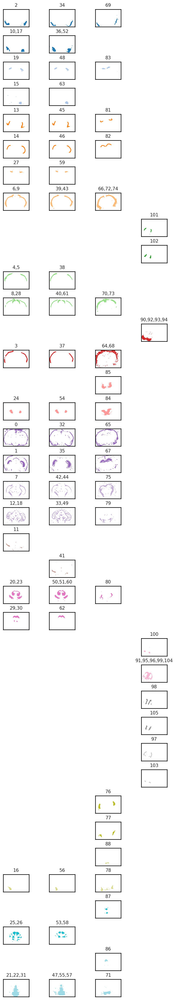

In [24]:
    
fig = plt.figure(figsize=(7,40))    
j=1
i=0
for c1 in color_clusters:
    if c1:
        for c2 in c1:
    #        plt.figure()
            g = s1[s1.cluster_id.isin(c2)]
            if g.shape[0]:
                ax = plt.subplot(n_subclusters,4,j, facecolor='white', frameon=True)
                plt.scatter(g.x, g.y, label=f'Cluster {i}', c=np.array([np.array(to_rgb(c_list[i])),]*len(g.x)), s=0.5, linewidths=0, rasterized=True)
                plt.axis('scaled')
                plt.ylim((0,np.amax(img_shape[:,0])))
                plt.xlim((0,np.amax(img_shape[:,1])))
                plt.title(','.join([str(int(x)) for x in g.cluster_id.unique().tolist()]),fontsize=10)
                plt.xticks([])
                plt.yticks([])
                ax.spines['right'].set_color('black')
                ax.spines['left'].set_color('black')
                ax.spines['top'].set_color('black')
                ax.spines['bottom'].set_color('black')
            j = j+1
            
            g = s2[s2.cluster_id.isin(c2)]
            if g.shape[0]:
                ax = plt.subplot(n_subclusters,4,j, facecolor='white', frameon=True)
                plt.scatter(g.x, g.y, label=f'Cluster {i}', c=np.array([np.array(to_rgb(c_list[i])),]*len(g.x)), s=0.5, linewidths=0, rasterized=True)
                plt.axis('scaled')
                plt.ylim((0,np.amax(img_shape[:,0])))
                plt.xlim((0,np.amax(img_shape[:,1])))
                plt.title(','.join([str(int(x)) for x in g.cluster_id.unique().tolist()]), fontsize=10)
                plt.xticks([])
                plt.yticks([]);
                ax.spines['right'].set_color('black')
                ax.spines['left'].set_color('black')
                ax.spines['top'].set_color('black')
                ax.spines['bottom'].set_color('black')                
            j = j+1
                
            g = s3[s3.cluster_id.isin(c2)]
            if g.shape[0]:
                ax = plt.subplot(n_subclusters,4,j, facecolor='white', frameon=True)
                plt.scatter(g.x, g.y, label=f'Cluster {i}', c=np.array([np.array(to_rgb(c_list[i])),]*len(g.x)), s=0.5, linewidths=0, rasterized=True)
                plt.axis('scaled')
                plt.ylim((0,np.amax(img_shape[:,0])))
                plt.xlim((0,np.amax(img_shape[:,1])))
                plt.title(','.join([str(int(x)) for x in g.cluster_id.unique().tolist()]), fontsize=10)
                plt.xticks([])
                plt.yticks([]);
                ax.spines['right'].set_color('black')
                ax.spines['left'].set_color('black')
                ax.spines['top'].set_color('black')
                ax.spines['bottom'].set_color('black')
            j = j+1
                
            g = s4[s4.cluster_id.isin(c2)]
            if g.shape[0]:
                ax = plt.subplot(n_subclusters,4,j, facecolor='white', frameon=True)
                plt.scatter(g.x, g.y, label=f'Cluster {i}', c=np.array([np.array(to_rgb(c_list[i])),]*len(g.x)), s=0.5, linewidths=0, rasterized=True)
                plt.axis('scaled')
                plt.ylim((0,np.amax(img_shape[:,0])))
                plt.xlim((0,np.amax(img_shape[:,1])))
                plt.title(','.join([str(int(x)) for x in g.cluster_id.unique().tolist()]), fontsize=10)
                plt.xticks([])
                plt.yticks([]);
                ax.spines['right'].set_color('black')
                ax.spines['left'].set_color('black')
                ax.spines['top'].set_color('black')
                ax.spines['bottom'].set_color('black')                
            j = j+1
            
    i=i+1

plt.subplots_adjust(hspace=0.5, wspace=0.2)
# fig.savefig('../figures/subclusters-full-gene-panel.svg', dpi=600)

# Marker Expression Clusters
Clustering of brain sections based on a subset of known biomarkers. The four normalized gene expression tables are projected in a common lower dimensional space and clustered individually.

In [216]:
markers = ['Calb2', 'Vip', 'Cck', 'Ntng1', 'Cacna2d1', 'Pvalb', 'Sst', 'Pcp4', 'Rprm', 'Rorb', 'Wfs1', 'Plcxd2', 'Crym', '3110035E14Rik', 'Slc24a2', 'Gda', 'Bcl11b', 'Calb1', 'Rgs4', 'Penk', 
'Fam19a1']

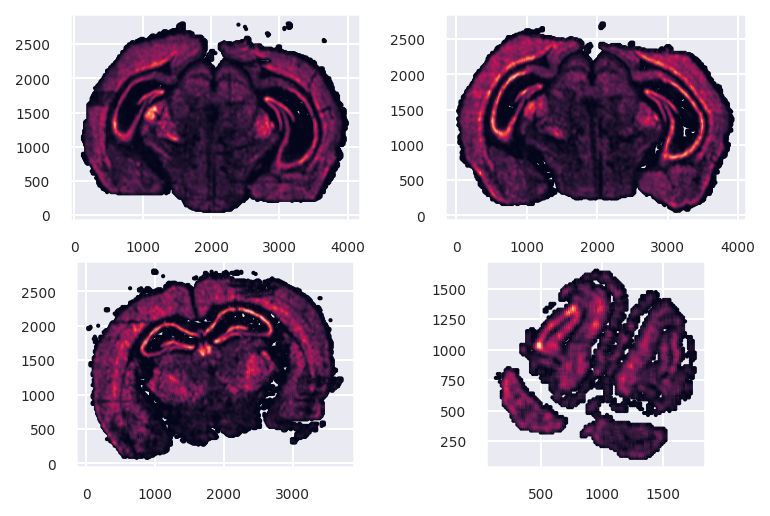

In [128]:
# load dataframes
img_shape = np.round(np.array([[22508, 33566],[22563, 31782],[22635, 29861],[13260, 15052]])/8).astype(np.uint)
expression_df = []
sample_df = []
for i,dataset in enumerate(datasets):
    plt.rcParams["figure.dpi"] = 150
    plt.subplot(2,2,i+1)    
    
    x_min = 0; x_max= img_shape[i,1];
    y_min = 0; y_max= img_shape[i,0];
    batch_size_px=16
    overlap = 16
    express_table = pd.read_pickle(path + 'data/results/'+dataset+'/express_table.hdf5')
    # Filter out non marker genes
    idx = [x for x in express_table.columns if x in markers]
    express_table = express_table.loc[:,idx]
    # Create sample_info
    sample_info = pd.DataFrame(data={'x':list(x for x in range(x_min,x_max,batch_size_px) for y in range(y_min,y_max,batch_size_px)), 'y':list(y for x in range(x_min,x_max,batch_size_px) for y in range(y_min,y_max,batch_size_px))}, index=list((str(x)+"x"+str(y)) for x in range(x_min,x_max,batch_size_px) for y in range(y_min,y_max,batch_size_px)))
    sample_info['total_counts'] = express_table.sum(axis=1)
    # Dropping empty batches
    express_table = express_table[sample_info.total_counts>10]
    sample_info = sample_info[sample_info.total_counts>10]
    
    expression_df.append(express_table)
    expression_df[i] = expression_df[i].rename(('{}_'+str(i)).format)

    sample_df.append(sample_info)
    sample_df[i] = sample_df[i].rename(('{}_'+str(i)).format)
    sample_df[i]['s'] = i
    plt.scatter(sample_df[i]['x'], sample_df[i]['y'], c=sample_df[i]['total_counts'],s=1);
    plt.axis('scaled');

## Normalize Gene Expression Tables

In [129]:
expression_df=pd.concat(expression_df,sort=True)
expression_df=expression_df.fillna(0)
sample_df=pd.concat(sample_df,sort=True)
                    
# Linear regression to account for library size and sequencing depth bias of each patch of gene expression
norm_expr_list = []
resid_expr_list = []
for s, dataset in enumerate(datasets):
    norm_expr_list.append(NaiveDE.stabilize(expression_df[sample_df.s==s].T).T)
    resid_expr_list.append(NaiveDE.regress_out(sample_df[sample_df.s==s], norm_expr_list[s][sample_df.s==s].T, 'np.log(total_counts)').T)

norm_expr = pd.concat(norm_expr_list)
resid_expr = pd.concat(resid_expr_list)
idx = resid_expr.var().sort_values(ascending=False).index

# Gene Expression Continuum

In [130]:
idx = resid_expr.var().sort_values(ascending=False).index
idx = [x for x in idx if x in markers]

In [ ]:
reducer = umap.UMAP(
        n_neighbors=100,
        min_dist=0.5,
        n_components=3,
        metric='correlation',
        random_state=42,
        init='spectral')

scaled_expr = np.vstack((scale(resid_expr.loc[sample_df.s==0,idx], 1),scale(resid_expr.loc[sample_df.s==1,idx], 1),scale(resid_expr.loc[sample_df.s==2,idx], 1),scale(resid_expr.loc[sample_df.s==3,idx], 1)))
Y_umap = reducer.fit_transform(scaled_expr)
Y_umap -= np.min(Y_umap, axis=0)
Y_umap /= np.max(Y_umap, axis=0)

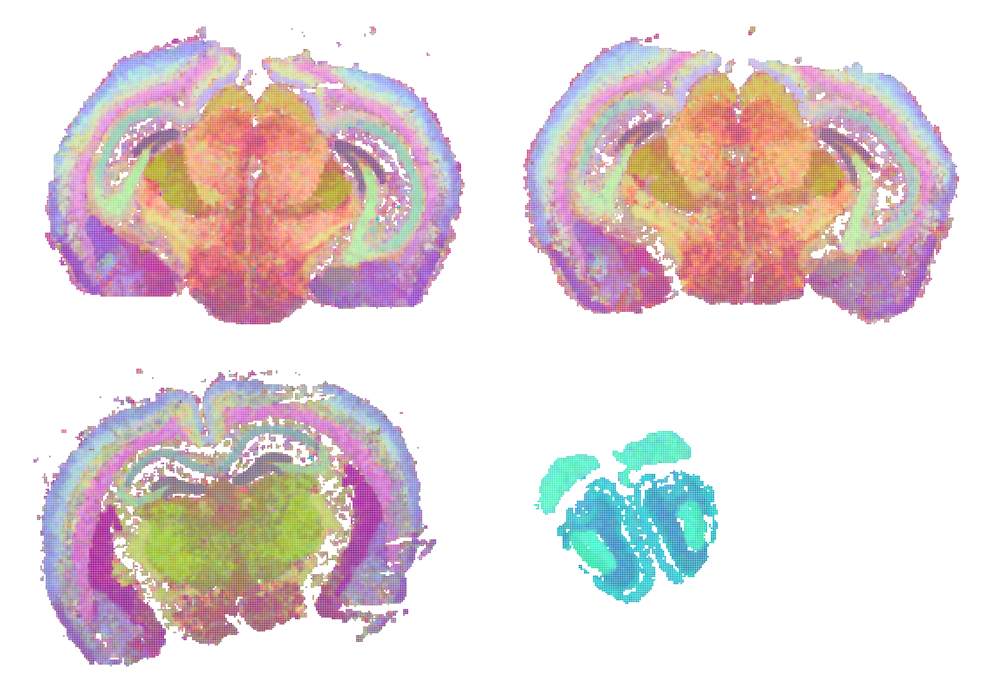

In [10]:
fig=plt.figure(figsize=(10,7),dpi=500)

ax1 = fig.add_subplot(2,2,1, facecolor='white', frameon = False)
# plt.subplot(2,2,1)
plt.scatter(sample_df.loc[sample_df.s==0,:].x, sample_df.loc[sample_df.s==0,:].y, c=Y_umap[sample_df.s==0,:], s=1, linewidths=0, rasterized=True);
plt.xticks([])
plt.yticks([]);
plt.axis('scaled');


ax = fig.add_subplot(2,2,2, facecolor='white', frameon =False, sharex=ax1)
# plt.subplot(2,2,2)
plt.scatter(sample_df.loc[sample_df.s==1,:].x, sample_df.loc[sample_df.s==1,:].y, c=Y_umap[sample_df.s==1,:], s=1, linewidths=0, rasterized=True);
plt.xticks([])
plt.yticks([]);
plt.axis('scaled');

ax = fig.add_subplot(2,2,3, facecolor='white', frameon =False, sharex=ax1)
# plt.subplot(2,2,3)
plt.scatter(sample_df.loc[sample_df.s==2,:].x, sample_df.loc[sample_df.s==2,:].y, c=Y_umap[sample_df.s==2,:], s=1, linewidths=0, rasterized=True);
plt.xticks([])
plt.yticks([]);
plt.axis('scaled');

ax = fig.add_subplot(2,2,4, facecolor='white', frameon =False, sharex=ax1)
# plt.subplot(2,2,4)
plt.scatter(sample_df.loc[sample_df.s==3,:].x, -sample_df.loc[sample_df.s==3,:].y, c=Y_umap[sample_df.s==3,:], s=1, linewidths=0, rasterized=True);
plt.xticks([])
plt.yticks([]);
plt.axis('scaled');

plt.subplots_adjust(hspace=0.05, wspace=0.02)

# fig.savefig('../figures/continuum-18-gene-panel.svg', dpi=600)

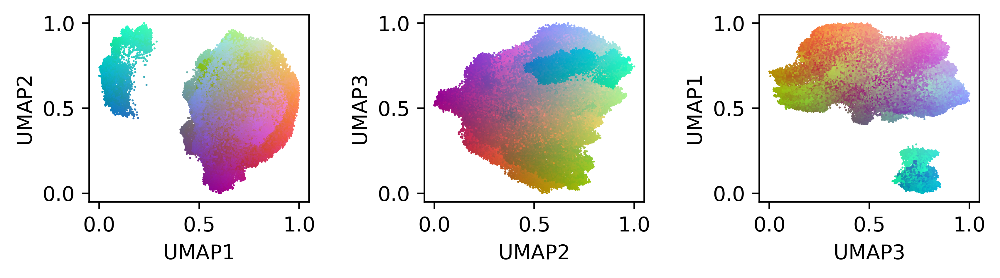

In [11]:
fig=plt.figure(figsize=(7,2),dpi=500)
cycled = [0,1,2,0]
for i in range(3):
    plt.subplot(1,3,i+1)
    plt.scatter(Y_umap[:,cycled[i]], Y_umap[:,cycled[i+1]], c=Y_umap, s=1, linewidths=0)
    plt.xlabel("UMAP"+str(cycled[i]+1))
    plt.ylabel("UMAP"+str(cycled[i+1]+1))
plt.tight_layout()       
# fig.savefig('../figures/continuum-18-gene-panel_b.png')

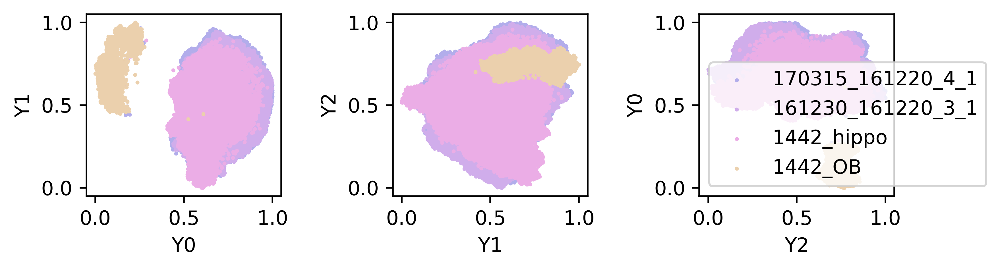

In [12]:
colors=["#B2ADEB", "#D0ADEB", "#EBADE6", "#EBD0AD"]

fig=plt.figure(figsize=(7,2),dpi=500)
cycled = [0,1,2,0]
for i in range(3):
    plt.subplot(1,3,i+1)
    plt.scatter(Y_umap[sample_df.s==0,cycled[i]], Y_umap[sample_df.s==0,cycled[i+1]],s=1, c=colors[0], label=datasets[0])
    plt.scatter(Y_umap[sample_df.s==1,cycled[i]], Y_umap[sample_df.s==1,cycled[i+1]],s=1, c=colors[1], label=datasets[1])
    plt.scatter(Y_umap[sample_df.s==2,cycled[i]], Y_umap[sample_df.s==2,cycled[i+1]],s=1, c=colors[2], label=datasets[2])
    plt.scatter(Y_umap[sample_df.s==3,cycled[i]], Y_umap[sample_df.s==3,cycled[i+1]],s=1, c=colors[3], label=datasets[3])
    plt.xlabel("Y"+str(cycled[i]))
    plt.ylabel("Y"+str(cycled[i+1]))
plt.legend(fontsize=10)
plt.tight_layout()

# Clustering

In [131]:
markers = ['Calb2', 'Vip', 'Cck', 'Ntng1', 'Cacna2d1', 'Pvalb', 'Sst', 'Pcp4', 'Rprm', 'Rorb', 'Wfs1', 'Plcxd2', 'Crym', '3110035E14Rik', 'Slc24a2', 'Gda', 'Bcl11b', 'Calb1', 'Rgs4', 'Penk', 
'Fam19a1']

# UMAP projection
idx = resid_expr.var().sort_values(ascending=False).index
idx = [x for x in idx if x in markers]
reducer = umap.UMAP(
        n_neighbors=100,
        min_dist=0.25,
        n_components=50,
        metric='correlation',
        random_state=42,
        init='spectral'
    )

scaled_expr = np.vstack((scale(resid_expr.loc[sample_df.s==0,idx], 1),scale(resid_expr.loc[sample_df.s==1,idx], 1),scale(resid_expr.loc[sample_df.s==2,idx], 1),scale(resid_expr.loc[sample_df.s==3,idx], 1)))
Y_umap = reducer.fit_transform(scaled_expr)
Y=Y_umap

In [132]:
# Leiden clustering
import scanpy as sc

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()

for i,df in enumerate(datasets):
    adata = sc.AnnData(X=Y[sample_df.s==i,:])
    sc.pp.neighbors(adata, n_neighbors=100)
    # Run Leiden clustering algorithm
    sc.tl.leiden(adata, resolution=0.8, random_state = 42)
    phi_hat = adata.obs['leiden'].values.astype(int)
    
    sample_df.loc[sample_df.s==i,'U1'] = Y[sample_df.s==i, 0]
    sample_df.loc[sample_df.s==i,'U2'] = Y[sample_df.s==i, 1]
    sample_df.loc[sample_df.s==i,'cluster18'] = phi_hat    

scanpy==1.5.1 anndata==0.7.3 umap==0.3.10 numpy==1.18.1 scipy==1.4.1 pandas==1.0.1 scikit-learn==0.21.3 statsmodels==0.11.1 python-igraph==0.8.2 leidenalg==0.8.0
computing neighbors
    using data matrix X directly
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:30)
running Leiden clustering
    finished: found 24 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:45)
computing neighbors
    using data matrix X directly
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:26)
running Leiden clustering
    finished: found 28 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:45)
computing neighbors
    using data matrix X directly
    finished: added to `.uns['neighbors']`
    `.obsp['distan

In [133]:
cluster_id_dict = dict(zip(sample_df.loc[:,['s','cluster18']].drop_duplicates().apply(tuple, axis=1).values, np.arange(sample_df.loc[:,['s','cluster18']].drop_duplicates().values.shape[0])))

sample_df['cluster18_id'] = sample_df.apply(lambda x: cluster_id_dict[(x['s'],x['cluster18'])], axis=1)

In [145]:
# Clusters Gene Expression Table
cluster_df = []
for i,df in enumerate(datasets):
    clusters=[]
    for c in np.unique(sample_df.loc[sample_df.s==i,'cluster18_id']):
        clusters.append(expression_df.loc[sample_df[(sample_df.s==i) & (sample_df.cluster18_id==c)].index,:])

    cluster_exp_tab = np.zeros((len(np.unique(sample_df.loc[sample_df.s==i,'cluster18_id'])),len(expression_df.columns.values)))

    for c, cluster in enumerate(np.unique(sample_df.loc[sample_df.s==i,'cluster18_id'])):
        for g, gene in enumerate(expression_df.columns.values):
            # Normalizationtion by cluster area
            cluster_exp_tab[c,g] = clusters[c].loc[:,gene].sum()/len(clusters[c])

    # Normalize by gene (column)
    cluster_exp_tab=cluster_exp_tab/cluster_exp_tab.sum(axis=0)[None,:]
    
    cluster_df.append(pd.DataFrame(cluster_exp_tab,columns=expression_df.columns, index=np.unique(sample_df.loc[sample_df.s==i,'cluster18_id']) ))

c=np.array(["#B2ADEB"]*len(cluster_df[0])).tolist() + np.array(["#D0ADEB"]*len(cluster_df[1])).tolist() + np.array(["#EBADE6"]*len(cluster_df[2])).tolist() + np.array(["#EBD0AD"]*len(cluster_df[3])).tolist()
cluster_exp_tab=pd.concat(cluster_df,sort=True)
cluster_exp_tab=cluster_exp_tab.fillna(0)

Clustering regions from the four sections are then combined together with hierarchical clustering based on the gene expression profile of each cluster regions

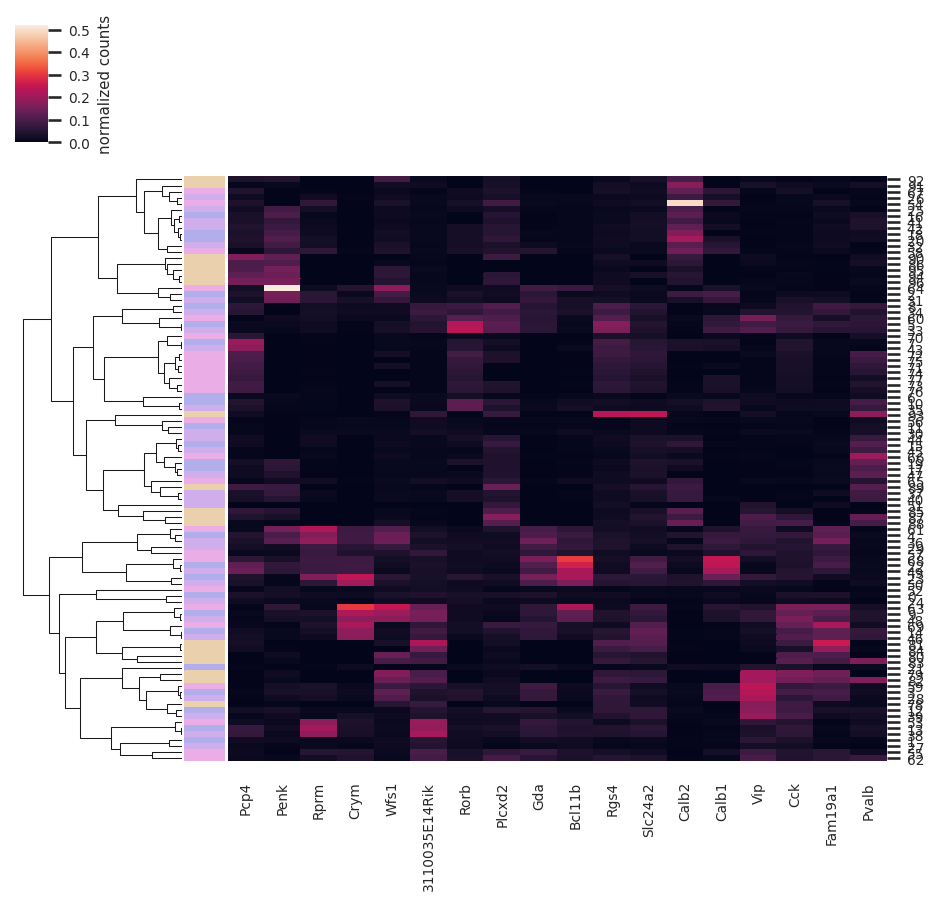

In [152]:
# Plot clustermap
sns.set(font_scale = 0.6)
# g=sns.clustermap(cluster_exp_tab,xticklabels=True, yticklabels=True, metric='correlation',row_colors=c, figsize=(10,15),  cbar_kws={'label': 'normalized counts'})
# g.savefig('../figures/Figure5-supplement1.pdf')

gene_order = ['Pcp4', 'Penk', 'Rprm', 'Crym', 'Wfs1', '3110035E14Rik', 'Rorb', 'Plcxd2', 'Gda', 'Bcl11b', 'Rgs4', 'Slc24a2', 'Calb2', 'Calb1', 'Vip', 'Cck', 'Fam19a1', 'Pvalb']
g=sns.clustermap(cluster_exp_tab.loc[:,gene_order],col_cluster=False, xticklabels=True, yticklabels=True, metric='correlation',row_colors=c, figsize=(7.5,6.5),  cbar_kws={'label': 'normalized counts'})
# g.savefig('../figures/Figure5b.pdf')

In [153]:
p = 20

G= nx.DiGraph()

Z= g.dendrogram_row.linkage
T = to_tree( Z , rd=False )
inorder(T,G)

dend = dendrogram(Z,
           truncate_mode='lastp',  # show only the last p merged clusters
           p=p,  # show only the last p merged clusters
           no_plot=True
           )
leafs = [x for x in G.nodes() if G.out_degree(x)==0]
truncated_dend_leafs = dend["leaves"]
color_clusters = []
i=0
for n in truncated_dend_leafs:
    n_list =[]
    for l in leafs:
        if nx.has_path(G,n,l):
            n_list.append(l)
    color_clusters.append(n_list)
    i=i+1    

cluster_exp_tab_idx = cluster_exp_tab.index.tolist()

In [154]:
color_clusters

[[92, 91, 67, 26, 54, 25, 16, 41, 42, 18, 20, 32, 58],
 [90, 86, 95, 94, 96],
 [64, 2, 31],
 [8, 34, 60, 5, 33],
 [70, 7, 43, 72, 75, 71, 74, 77, 73, 76],
 [6, 10, 35],
 [93],
 [56, 11, 30],
 [44, 15, 45, 66, 19, 17, 47, 65, 89, 37, 40],
 [51],
 [85, 87, 88],
 [61, 4, 36, 29, 57],
 [68, 22, 49, 23, 50],
 [52],
 [0, 24],
 [63, 9, 48, 69, 14, 46],
 [81, 84, 80, 83],
 [21, 79, 82, 59, 3, 28, 78, 12, 39],
 [53, 13, 38],
 [1, 27, 55, 62]]

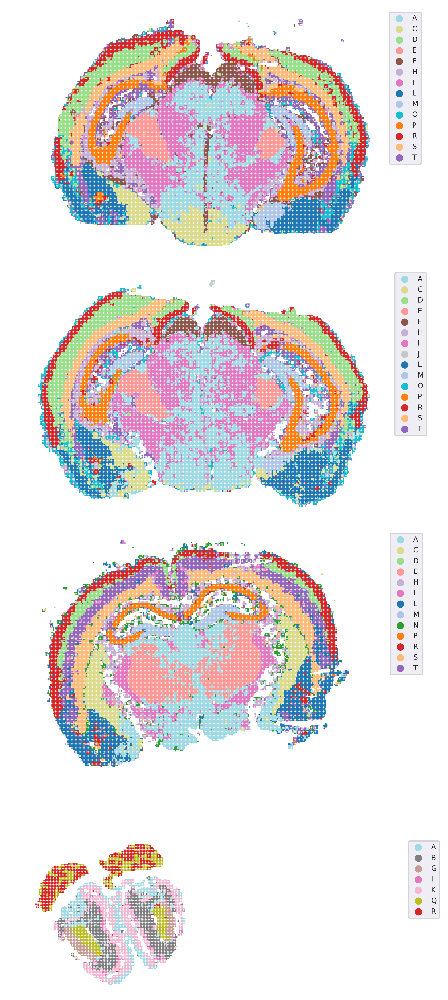

In [156]:
from cycler import cycler
import matplotlib as mpl
from matplotlib.colors import to_rgb
mpl.rcParams['axes.prop_cycle'] = cycler(color=["#1f77b4","#aec7e8","#ff7f0e","#ffbb78","#2ca02c","#98df8a","#d62728","#ff9896","#9467bd","#c5b0d5","#8c564b","#c49c94","#e377c2","#f7b6d2","#7f7f7f","#c7c7c7","#bcbd22","#dbdb8d","#17becf","#9edae5"])
c_list=[
    "#9edae5", #A 
    "#7f7f7f", #B 
    "#dbdb8d", #C 
    "#98df8a", #D 
    "#ff9896", #E 
    "#8c564b", #F
    "#c49c94", #G
    "#c5b0d5", #H 
    "#e377c2", #I 
    "#c7c7c7", #J
    "#f7b6d2", #K 
    "#1f77b4", #L 
    "#aec7e8", #M 
    "#2ca02c", #N 
    "#17becf", #O
    "#ff7f0e", #P
    "#bcbd22", #Q
    "#d62728", #R 
    "#ffbb78", #S 
    "#9467bd" #T 
]
fig=plt.figure(figsize=(6,16),dpi=500)


ax1 = fig.add_subplot(4,1,1, facecolor='white', frameon =False)
c_label = [chr(x) for x in range(65,91)]

i=0
for c in color_clusters:
    g = sample_df.loc[(sample_df.s==0) & (sample_df.cluster18_id.isin(c)),:]
    if not g.empty:
        plt.scatter(g.x, g.y, label=c_label[i], c=np.array([np.array(to_rgb(c_list[i])),]*len(g.x)), s=1.5, linewidths=0, rasterized=True)
    i = i+1
    
plt.xticks([])
plt.yticks([]);
plt.axis('scaled');
ax1.spines['right'].set_color('black')
ax1.spines['left'].set_color('black')
ax1.spines['top'].set_color('black')
ax1.spines['bottom'].set_color('black')
plt.legend(bbox_to_anchor=(1, 1),loc=2, markerscale=5. ,prop={'size': 6})

ax = fig.add_subplot(4,1,2, facecolor='white', frameon =False, sharex=ax1)
i=0
for c in color_clusters:
    g = sample_df.loc[(sample_df.s==1) & (sample_df.cluster18_id.isin(c)),:]
    if not g.empty:
        plt.scatter(g.x, g.y, label=c_label[i], c=np.array([np.array(to_rgb(c_list[i])),]*len(g.x)), s=1.5, linewidths=0, rasterized=True)
    i = i+1
    
plt.xticks([])
plt.yticks([]);
plt.axis('scaled');
ax.spines['right'].set_color('black')
ax.spines['left'].set_color('black')
ax.spines['top'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.legend(bbox_to_anchor=(1, 1),loc=2, markerscale=5. ,prop={'size': 6})

ax = fig.add_subplot(4,1,3, facecolor='white', frameon =False, sharex=ax1)
i=0
for c in color_clusters:
    g = sample_df.loc[(sample_df.s==2) & (sample_df.cluster18_id.isin(c)),:]
    if not g.empty:
        plt.scatter(g.x, g.y, label=c_label[i], c=np.array([np.array(to_rgb(c_list[i])),]*len(g.x)), s=1.5, linewidths=0, rasterized=True)
    i = i+1
    
plt.xticks([])
plt.yticks([]);
plt.axis('scaled');
ax.spines['right'].set_color('black')
ax.spines['left'].set_color('black')
ax.spines['top'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.legend(bbox_to_anchor=(1, 1),loc=2, markerscale=5. ,prop={'size': 6})

ax = fig.add_subplot(4,1,4, facecolor='white', frameon =False, sharex=ax1)
i=0
for c in color_clusters:
    g = sample_df.loc[(sample_df.s==3) & (sample_df.cluster18_id.isin(c)),:]
    if not g.empty:
        plt.scatter(g.x, -g.y, label=c_label[i], c=np.array([np.array(to_rgb(c_list[i])),]*len(g.x)), s=1.5, linewidths=0, rasterized=True)
    i = i+1
    
plt.xticks([])
plt.yticks([]);
plt.axis('scaled');
ax.spines['right'].set_color('black')
ax.spines['left'].set_color('black')
ax.spines['top'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.legend(bbox_to_anchor=(1, 1),loc=2, markerscale=5. ,prop={'size': 6})

plt.subplots_adjust(hspace=0.05, wspace=0.02)

# fig.savefig('../figures/clusters-18-gene-panel.svg', dpi=600)

In [157]:
# Save sample_df dataframe
for i,c in enumerate(color_clusters):
    sample_df.loc[sample_df.cluster18_id.isin(c),'top_cluster'] = i
    sample_df.to_csv(path + 'data/results/sample_info18.csv')

Plot subclusters of 20 top cluster regions

In [158]:
c1 = cluster_df[0]; s1 = sample_df[sample_df.s==0]
c2 = cluster_df[1]; s2 = sample_df[sample_df.s==1]
c3 = cluster_df[2]; s3 = sample_df[sample_df.s==2]
c4 = cluster_df[3]; s4 = sample_df[sample_df.s==3]
# Find sub-clusters
color_clusters = []
for n in truncated_dend_leafs:
    leafs = [x for x in G.nodes() if G.out_degree(x)==0 and nx.has_path(G,n,x)]
    succ = list(G.successors(n))
    color_subclusters = []
    for s in succ:
        color_subclusters.append([x for x in G.nodes() if G.out_degree(x)==0 and nx.has_path(G,s,x)])
    color_clusters.append(color_subclusters)

In [159]:
n_subclusters = len(sum(color_clusters, []))

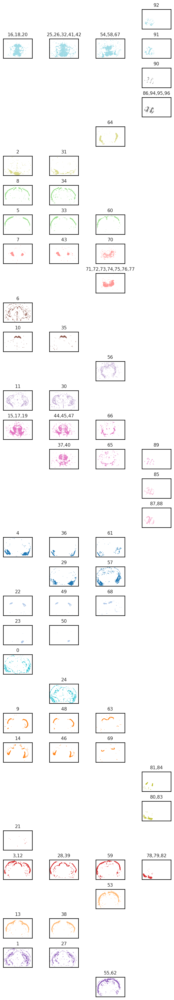

In [160]:
fig = plt.figure(figsize=(7,40))    
j=1
i=0
for c1 in color_clusters:
    if c1:
        for c2 in c1:
    #        plt.figure()
            g = s1[s1.cluster18_id.isin(c2)]
            if g.shape[0]:
                ax = plt.subplot(n_subclusters,4,j, facecolor='white', frameon=True)
                plt.scatter(g.x, g.y, label=f'Cluster {i}', c=np.array([np.array(to_rgb(c_list[i])),]*len(g.x)), s=0.5, linewidths=0, rasterized=True)
                plt.axis('scaled')
                plt.ylim((0,np.amax(img_shape[:,0])))
                plt.xlim((0,np.amax(img_shape[:,1])))
                plt.title(','.join([str(int(x)) for x in g.cluster18_id.unique().tolist()]),fontsize=10)
                plt.xticks([])
                plt.yticks([])
                ax.spines['right'].set_color('black')
                ax.spines['left'].set_color('black')
                ax.spines['top'].set_color('black')
                ax.spines['bottom'].set_color('black')
            j = j+1
            
            g = s2[s2.cluster18_id.isin(c2)]
            if g.shape[0]:
                ax = plt.subplot(n_subclusters,4,j, facecolor='white', frameon=True)
                plt.scatter(g.x, g.y, label=f'Cluster {i}', c=np.array([np.array(to_rgb(c_list[i])),]*len(g.x)), s=0.5, linewidths=0, rasterized=True)
                plt.axis('scaled')
                plt.ylim((0,np.amax(img_shape[:,0])))
                plt.xlim((0,np.amax(img_shape[:,1])))
                plt.title(','.join([str(int(x)) for x in g.cluster18_id.unique().tolist()]), fontsize=10)
                plt.xticks([])
                plt.yticks([]);
                ax.spines['right'].set_color('black')
                ax.spines['left'].set_color('black')
                ax.spines['top'].set_color('black')
                ax.spines['bottom'].set_color('black')                
            j = j+1
                
            g = s3[s3.cluster18_id.isin(c2)]
            if g.shape[0]:
                ax = plt.subplot(n_subclusters,4,j, facecolor='white', frameon=True)
                plt.scatter(g.x, g.y, label=f'Cluster {i}', c=np.array([np.array(to_rgb(c_list[i])),]*len(g.x)), s=0.5, linewidths=0, rasterized=True)
                plt.axis('scaled')
                plt.ylim((0,np.amax(img_shape[:,0])))
                plt.xlim((0,np.amax(img_shape[:,1])))
                plt.title(','.join([str(int(x)) for x in g.cluster18_id.unique().tolist()]), fontsize=10)
                plt.xticks([])
                plt.yticks([]);
                ax.spines['right'].set_color('black')
                ax.spines['left'].set_color('black')
                ax.spines['top'].set_color('black')
                ax.spines['bottom'].set_color('black')
            j = j+1
                
            g = s4[s4.cluster18_id.isin(c2)]
            if g.shape[0]:
                ax = plt.subplot(n_subclusters,4,j, facecolor='white', frameon=True)
                plt.scatter(g.x, g.y, label=f'Cluster {i}', c=np.array([np.array(to_rgb(c_list[i])),]*len(g.x)), s=0.5, linewidths=0, rasterized=True)
                plt.axis('scaled')
                plt.ylim((0,np.amax(img_shape[:,0])))
                plt.xlim((0,np.amax(img_shape[:,1])))
                plt.title(','.join([str(int(x)) for x in g.cluster18_id.unique().tolist()]), fontsize=10)
                plt.xticks([])
                plt.yticks([]);
                ax.spines['right'].set_color('black')
                ax.spines['left'].set_color('black')
                ax.spines['top'].set_color('black')
                ax.spines['bottom'].set_color('black')                
            j = j+1
            
    i=i+1

plt.subplots_adjust(hspace=0.5, wspace=0.2)
# fig.savefig('../figures/subclusters-18-gene-panel.svg', dpi=600)

## Evaluate clusters with high correlation

In [294]:
diff_exp_clusters = sample_df[sample_df.s.isin([0,1])].top_cluster.unique()
diff_exp_clusters

array([14., 19.,  2., 17., 11.,  3.,  5.,  4., 15.,  7., 18.,  8.,  0.,
       12.,  9.])

In [295]:
# Print cluster correlations
cluster_corr = []
for j,c in enumerate(diff_exp_clusters):
    if sample_df[(sample_df.s.isin([0,1])) & (sample_df.top_cluster==c)].cluster18_id.unique().shape[0]>1:
        corr = cluster_exp_tab.loc[sample_df[(sample_df.s.isin([0,1])) & (sample_df.top_cluster==c)].cluster18_id.unique(),:].T.corr()
        corr = corr.values[np.triu_indices_from(corr.values,1)].mean()
        print("Top cluster "+ str(c) +" correlation: "+ str(corr))
        cluster_corr.append(corr)
    else:
        cluster_corr.append(0)

Top cluster 14.0 correlation: 0.8822729821526886
Top cluster 19.0 correlation: 0.9005247037182409
Top cluster 2.0 correlation: 0.9076018412921477
Top cluster 17.0 correlation: 0.7250645987672681
Top cluster 11.0 correlation: 0.8427544251015581
Top cluster 3.0 correlation: 0.7161831516384751
Top cluster 5.0 correlation: 0.7973543621857355
Top cluster 4.0 correlation: 0.9947750910746992
Top cluster 15.0 correlation: 0.7144407485686456
Top cluster 7.0 correlation: 0.8927079919033976
Top cluster 18.0 correlation: 0.9890582248413762
Top cluster 8.0 correlation: 0.8310750007348843
Top cluster 0.0 correlation: 0.8635858730056374
Top cluster 12.0 correlation: 0.6855840191035308


Filter clusters with correlation lower than 0.8

In [296]:
corr_th = 0.8
cluster_corr = np.array(cluster_corr)
d = dict(zip(np.arange(len(cluster_corr)),[x for x in np.where(cluster_corr>corr_th)[0]]))
color_clusters = [diff_exp_clusters[x] for x in np.where(cluster_corr>corr_th)[0]]
color_clusters

[14.0, 19.0, 2.0, 11.0, 4.0, 7.0, 18.0, 8.0, 0.0]

In [297]:
# load dataframes
img_shape = np.round(np.array([[22508, 33566],[22563, 31782],[22635, 29861],[13260, 15052]])/8).astype(np.uint)
expression_df = []
for i,dataset in enumerate(datasets[:2]):    
    x_min = 0; x_max= img_shape[i,1];
    y_min = 0; y_max= img_shape[i,0];
    batch_size_px=16
    overlap = 16
    express_table = pd.read_pickle('../data/results/'+dataset+'/express_table.hdf5')
    express_table = express_table.rename(('{}_'+str(i)).format)
    # Filter out non marker genes
    idx = [x for x in express_table.columns if x in markers]
    # Dropping empty batches
    express_table = express_table[express_table.index.isin(sample_df[sample_df.s==i].index)]
    
    expression_df.append(express_table)

In [298]:
expression_df=pd.concat(expression_df,sort=True)
expression_df=expression_df.fillna(0)
                    
# Linear regression to account for library size and sequencing depth bias of each patch of gene expression
norm_expr_list = []
resid_expr_list = []
for s, dataset in enumerate(datasets[:2]):
    norm_expr_list.append(NaiveDE.stabilize(expression_df.loc[sample_df[sample_df.s==s].index,:].T).T)
    resid_expr_list.append(NaiveDE.regress_out(sample_df[sample_df.s==s], norm_expr_list[s].T, 'np.log(total_counts)').T)

norm_expr = pd.concat(norm_expr_list)
resid_expr = pd.concat(resid_expr_list)
idx = resid_expr.var().sort_values(ascending=False).index

In [299]:
# Save gene expression matrix for seurat DE analysis
sample_df[(sample_df.s.isin([0,1])) & (sample_df.top_cluster.isin(color_clusters))].to_csv(path + 'data/results/sample_info_de.csv')
pos_res_exp = resid_expr - resid_expr.min().min()
idx = [x for x in resid_expr.columns if not x in markers]
pos_res_exp = pos_res_exp.loc[sample_df[(sample_df.s.isin([0,1])) & (sample_df.top_cluster.isin(color_clusters))].index,idx]
pos_res_exp.T.to_csv('../data/results/residuals.csv')

expression_df.loc[sample_df[(sample_df.s.isin([0,1])) & (sample_df.top_cluster.isin(color_clusters))].index,idx].T.to_csv(path + 'data/results/expression.csv')
scaled_expr = pd.DataFrame(scale(resid_expr.loc[:,idx], 1), index=resid_expr.index, columns=idx)
scaled_expr.loc[sample_df[(sample_df.s.isin([0,1])) & (sample_df.top_cluster.isin(color_clusters))].index,idx].T.to_csv(path + 'data/results/scaled.csv')

In [300]:
scaled_expr.loc[sample_df[(sample_df.s.isin([0,1])) & (sample_df.top_cluster.isin(color_clusters))].index,idx].shape

(42467, 60)

## Find differentially expressed features between clusters
Run differential expression analysis with Seurat 3 before continue. Execute in terminal:

`Rscript DE_analysis.R`

In [ ]:
!Rscript DE_analysis.R

In [288]:
# Read DE results
def get_label(x):
    c_label = [chr(int(x)) for x in range(65,91)]
    return c_label[int(x)]# 

de_markers = pd.read_csv('../data/results/markers.csv')
de_markers = de_markers[de_markers.avg_diff>0]
de_markers.cluster = de_markers.cluster.apply(get_label)
de_markers

,p_val,avg_diff,pct.1,pct.2,p_val_adj,Gene,cluster
0,0.000000e+00,16.956044,0.985,0.980,0.000000e+00,Gap43,A
1,0.000000e+00,10.465933,0.974,0.850,0.000000e+00,Scg2,A
2,0.000000e+00,4.491325,0.939,0.705,0.000000e+00,Zcchc12,A
3,2.248699e-264,4.591301,0.999,0.998,1.349220e-262,Aldoc,A
4,2.464444e-21,10.780212,0.989,0.919,1.478666e-19,Plp1,A
5,0.000000e+00,27.141433,0.995,0.980,0.000000e+00,Gap43,C
6,0.000000e+00,16.881911,0.973,0.871,0.000000e+00,Scg2,C
7,0.000000e+00,11.229808,0.837,0.605,0.000000e+00,Tac1,C
8,0.000000e+00,7.272315,0.957,0.745,0.000000e+00,Zcchc12,C
9,1.411490e-104,7.171543,0.968,0.873,8.468941e-103,Gad1,C


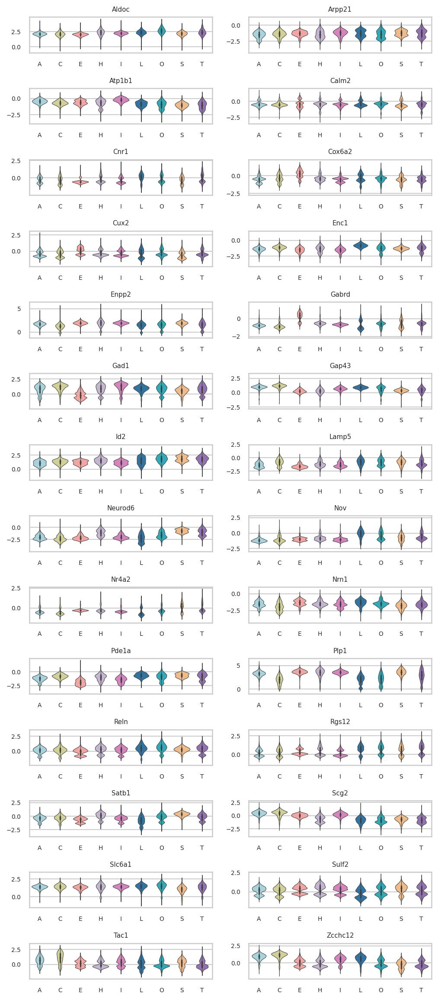

In [289]:
sns.set_style("whitegrid") 

c_list=[
    "#9edae5", #A 
    "#7f7f7f", #B 
    "#dbdb8d", #C 
    "#98df8a", #D 
    "#ff9896", #E 
    "#8c564b", #F
    "#c49c94", #G
    "#c5b0d5", #H 
    "#e377c2", #I 
    "#c7c7c7", #J
    "#f7b6d2", #K 
    "#1f77b4", #L 
    "#aec7e8", #M 
    "#2ca02c", #N 
    "#17becf", #O
    "#ff7f0e", #P
    "#bcbd22", #Q
    "#d62728", #R 
    "#ffbb78", #S 
    "#9467bd" #T 
]

# DE analysis of genes not in marker list (not used for clustering)
scaled_expr_de = scaled_expr.loc[sample_df[(sample_df.s.isin([0,1])) & (sample_df.top_cluster.isin(color_clusters))].index,idx]
sample_df_de = sample_df[(sample_df.s.isin([0,1])) & (sample_df.top_cluster.isin(color_clusters))]
de_markers = de_markers.Gene.unique()
idx=[x for x in expression_df.loc[sample_df[(sample_df.s.isin([0,1])) & (sample_df.top_cluster.isin(color_clusters))].index,idx].columns if x in de_markers]
fig = plt.figure(figsize=(8,40))
for i,gene in enumerate(idx):
    gene_exp = pd.DataFrame({'Normalized_Expression':scaled_expr_de.loc[:,gene], 's':sample_df_de.s, 'top_cluster':sample_df_de.top_cluster.astype(np.uint).apply(get_label)})
    plt.subplot(len(idx),2,i+1)
    ax = sns.violinplot(x="top_cluster", y="Normalized_Expression", data=gene_exp, palette=[c_list[int(x)] for x in np.sort(color_clusters)], order=np.sort(gene_exp.top_cluster.unique()), linewidth=0.5, rasterized=True)
    #ax.legend_.remove()
    ax.set_xlabel("")
    ax.set_ylabel("")
    plt.title(gene)
plt.subplots_adjust(hspace=1)
    
# fig.savefig('../figures/de_analysis1.svg', dpi=600)    

## Find Differentially Expressed Genes between samples

In [310]:
# Read DE results
def get_label(x):
    c_label = [chr(int(x)) for x in range(65,91)]
    return c_label[int(x)]

markers_de = pd.read_csv('../data/results/markers_samples.csv')
markers_de = markers_de.set_index('Gene')
markers_de.cluster = markers_de.cluster.apply(get_label)
markers_de

,p_val,avg_diff,pct.1,pct.2,p_val_adj,cluster
Gene,,,,,,
Id2,0.000000,9.234815,1.000,0.984,0.0,A
Calm2,0.000000,7.873442,0.988,0.307,0.0,A
Enpp2,0.000000,2.150459,0.990,0.965,0.0,A
Snca,0.000000,2.141847,0.820,0.239,0.0,A
Arpp21,0.000000,1.630690,0.926,0.724,0.0,A
...,...,...,...,...,...,...
Sulf2,0.032855,0.597628,0.616,0.444,1.0,T
Cdh13,0.075779,0.178225,0.430,0.315,1.0,T
Serpini1,0.118237,0.232173,0.449,0.328,1.0,T


In [311]:
scaled_expr_de = scaled_expr.loc[sample_df[(sample_df.s.isin([0,1])) & (sample_df.top_cluster.isin(color_clusters))].index,idx]
sample_df_de = sample_df[(sample_df.s.isin([0,1])) & (sample_df.top_cluster.isin(color_clusters))]

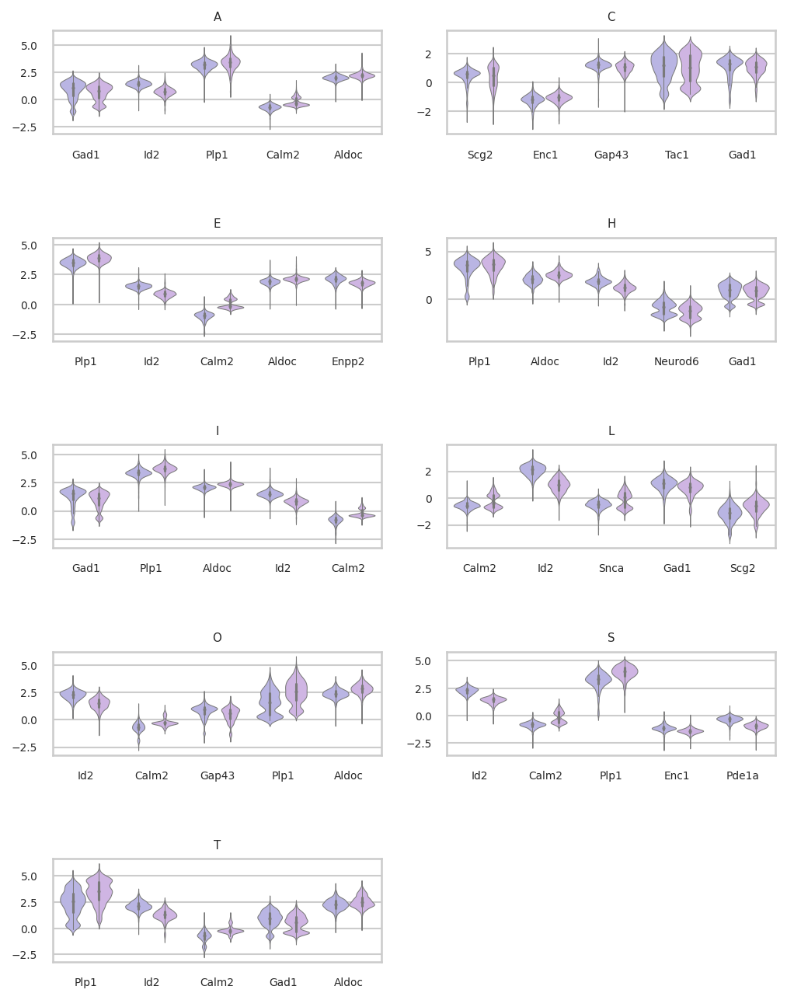

In [315]:
clusters = np.sort(markers_de.cluster.unique())
colors=["#B2ADEB", "#D0ADEB"]

fig = plt.figure(figsize=(8,20))
j=1
for i in np.sort(color_clusters):
    c = get_label(i)
    markers_tmp = markers_de[markers_de.cluster==c]
    markers_tmp = markers_tmp[markers_tmp.p_val_adj<0.01]
    marker_list = markers_tmp.avg_diff.abs().sort_values(ascending=False).head(5).index.values
    gene_exp = scaled_expr_de.loc[sample_df_de.top_cluster==i, marker_list].copy()
    gene_exp['s'] = sample_df_de.s
    gene_exp = gene_exp.melt('s')
    gene_exp = gene_exp.rename(columns={"variable": "Gene", "value": "Normalized_Expression"})

    plt.subplot(len(color_clusters),2,j)
    ax = sns.violinplot(x="Gene", y="Normalized_Expression",hue='s', palette=colors ,data=gene_exp, linewidth=0.5, rasterized=True)
    ax.legend_.remove()
    ax.set_xlabel("")
    ax.set_ylabel("")
    plt.title(c)
    j = j+1
    
plt.subplots_adjust(hspace=1)
# fig.savefig('../figures/de_analysis2.svg', dpi=600)    